In [2]:
import librosa
import numpy as np
from matplotlib import pyplot as plt
from pydub import AudioSegment
from scipy import signal
from sklearn import preprocessing
import os
import matplotlib.pyplot as plt
from scipy import signal
from scipy.io import wavfile
import tensorflow_io as tfio
import librosa.display
import IPython.display as ipd
import warnings
warnings.simplefilter("ignore", UserWarning)
from tensorflow.keras.callbacks import EarlyStopping

2022-06-21 14:16:14.953945: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-06-21 14:16:14.953967: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [3]:
os.getcwd()

'/home/stud/m/mh361/share'

In [4]:
pathAudio = '/home/stud/m/mh361/share/sample-same/'
files = librosa.util.find_files(pathAudio, ext=['mp3'])
songa = []
songb = []
songc = []
for file in files:
    if "Dee Yan-Key-Yuletide" in file:
        songa.append(file)
    if "Holizna - So Broke" in file:
        songb.append(file)
    if "Independent Music Licensing Collective" in file:
        songc.append(file)
filesa = sorted(songa, key=lambda x: int(x.split('_')[-1].split(".")[0]))
filesb = sorted(songb, key=lambda x: int(x.split('_')[-1].split(".")[0]))
filesc = sorted(songc, key=lambda x: int(x.split('_')[-1].split(".")[0]))
filesa = filesa[:-1]
filesb = filesb[:-1]
filesc = filesc[:-1]

files = filesa+filesb+filesc

In [5]:
def normalize_sample(sample):
    array_of_samples = sample.get_array_of_samples()
    np_arr = np.array(array_of_samples)
    np_arr = np_arr.reshape(1, -1)
    return preprocessing.normalize(np_arr)

def NormalizeData(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))


samples = []
samples_sec_canal = []
for file_name in files:
    x, sr = librosa.load(file_name, sr=44100)
    #sample = AudioSegment.from_mp3(file_name)
    #mono_samples = sample.split_to_mono()
    #normalized_sample = normalize_sample(mono_samples[0])[0]
    normalized_sample = NormalizeData(x)
    #resampled_sample = signal.resample(normalized_sample, int(len(normalized_sample) / 35))
    resampled_sample = signal.resample(normalized_sample, 4700)
    samples.append(resampled_sample)
    #normalized_sample_sec_canal = normalize_sample(mono_samples[1])[0]
    #resampled_sample_sec_canal = signal.resample(normalized_sample_sec_canal, 4700)
    #samples_sec_canal.append(resampled_sample_sec_canal)

/tmp/ipykernel_2569673/33493767.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15, 5))


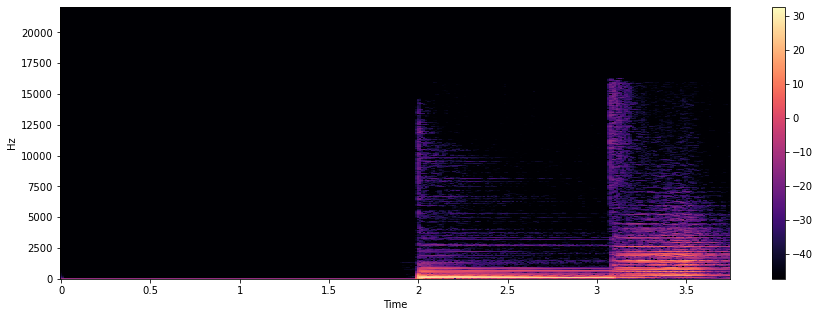

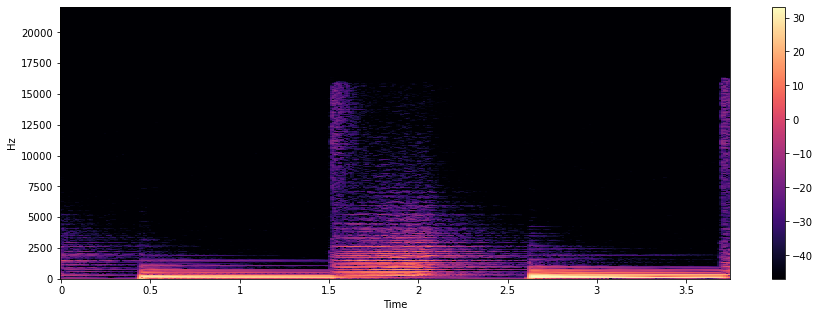

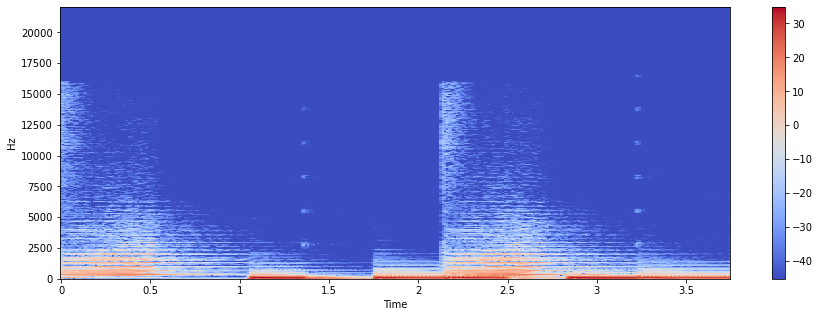

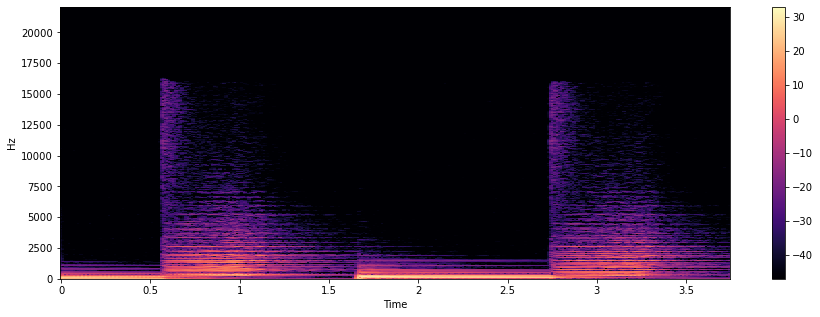

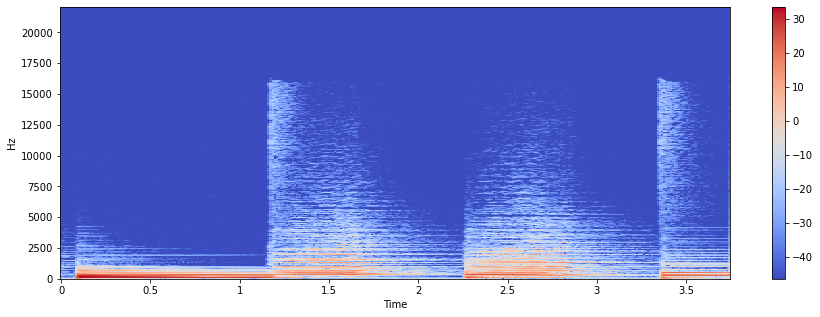

...

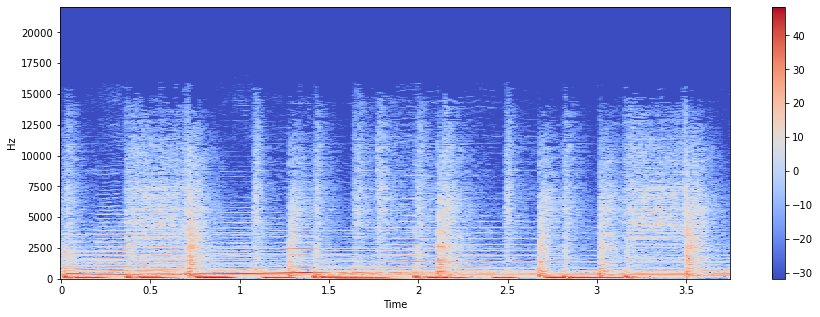

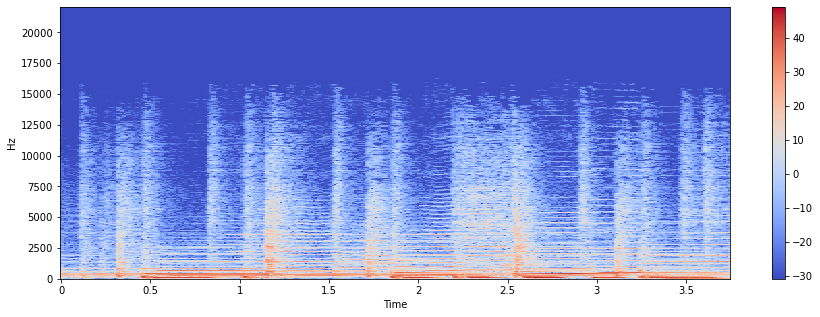

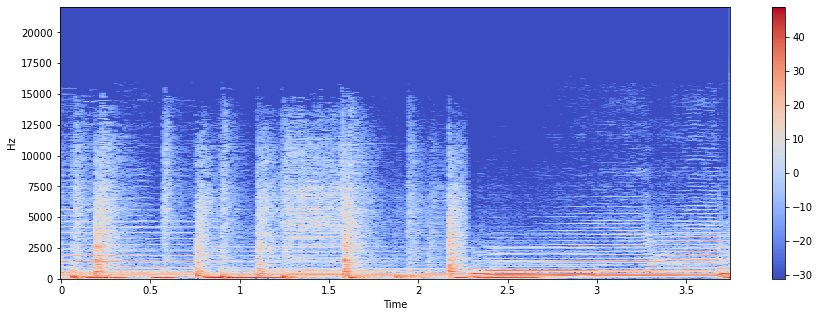

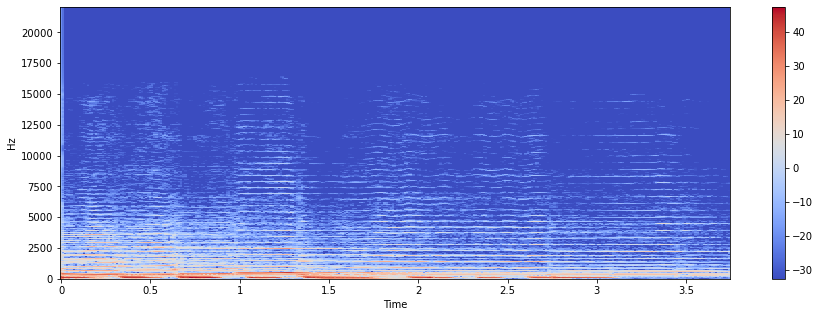

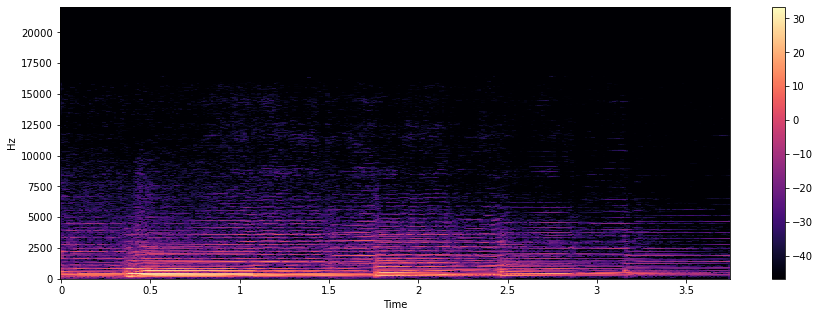

In [8]:
def NormalizeData(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

samples = []
for file_name in files:
    X, sr = librosa.load(file_name, sr=44100)
    #scaled_x = NormalizeData(X)
    X = librosa.stft(X)
    Xdb = librosa.amplitude_to_db(abs(X))
    samples.append(Xdb)
    
    #fig = plt.figure()
    #fig.savefig(file_name + (".png"))
    #librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
    #plt.colorbar()
    
    plt.figure(figsize=(15, 5))
    librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
    plt.colorbar()

In [15]:
type(Xdb)

numpy.ndarray

In [16]:
Xdb.shape

(1025, 323)

In [1]:
print(len(Xdb[1]))

NameError: name 'Xdb' is not defined

In [17]:
print(samples)

[array([[-13.368186,  -8.162128,  -7.422267, ..., -10.905738, -10.065389,
         -9.358188],
       [-15.193951, -12.591141, -13.505648, ..., -17.160725, -16.243862,
        -13.705915],
       [-20.836445, -28.745338, -47.266376, ..., -33.163567, -30.642395,
        -28.915699],
       ...,
       [-47.266376, -47.266376, -47.266376, ..., -47.266376, -47.266376,
        -47.266376],
       [-47.266376, -47.266376, -47.266376, ..., -47.266376, -47.266376,
        -47.266376],
       [-47.266376, -47.266376, -47.266376, ..., -47.266376, -47.266376,
        -47.266376]], dtype=float32), array([[-14.404965 ,  -8.354074 ,  -7.4045553, ..., -12.155662 ,
        -37.990288 , -14.559874 ],
       [-15.11971  , -12.266612 , -13.81432  , ...,  -3.8487566,
        -10.088259 , -14.83913  ],
       [-17.035116 , -24.914568 , -30.972261 , ...,   5.590147 ,
         -1.3723769,   0.9409312],
       ...,
       [-46.90865  , -46.90865  , -46.90865  , ..., -46.90865  ,
        -46.90865  , -46.9086

In [10]:
shortest_length = min(map(len, samples))
shortest_length

NameError: name 'samples' is not defined

In [ ]:
shortest_length = max(map(len, samples))
shortest_length

In [ ]:
samples = np.array(samples)


In [ ]:
X_train = []
Y_train = []
for i in range(len(samples)):
    Y_train.append(1)
    if i < len(samples)-1:
        x = list(samples[i])
        y = list(samples[i+1])
        z = x + y
        X_train.append(z)
    else:
        x = list(samples[i])
        y = list(samples[0])
        z = x + y
        X_train.append(z)

In [ ]:
X_train

In [ ]:
import random

X_false = []
Y_false = []
shuffled = samples
random.shuffle(shuffled)
for i in range(len(shuffled)):
    Y_false.append(0)
    if i < len(shuffled)-1:
        x = list(shuffled[i])
        y = list(shuffled[i+1])
        z = x + y
        X_false.append(z)   
    else:
        x = list(shuffled[i])
        y = list(shuffled[0])
        z = x + y
        X_false.append(z)



In [ ]:
X_train_total = []
Y_train_total = []
'''for i in range(len(X)):
    X_train.append(X[i])
    X_train.append(X_false[i])
    Y_train.append(True)
    Y_train.append(False)'''
X_train_total.append(X_train)
X_train_total.append(X_false)
Y_train_total.append(Y_train)
Y_train_total.append(Y_false)

In [ ]:
X_train_total = np.array(X_train_total)
X_train_total.shape

In [ ]:
Y_train_total = np.array(Y_train_total)
Y_train_total.shape

In [ ]:
X_train_total = X_train_total.reshape(-1, 9400)
X_train_total.shape

In [ ]:
Y_train_total = np.array(Y_train_total).reshape(-1, 1)
Y_train_total.shape

In [ ]:
from keras.layers import LSTM, Dense, Conv1D, MaxPool1D
from keras.models import Sequential

model = Sequential()
model.add(Conv1D(filters=50, kernel_size=2, input_shape=(9400, 1))) #filter=100, kernel_size=4
model.add(MaxPool1D(pool_size=2, strides=2)) # pool_size=4, strides=4
model.add(LSTM(20, activation='sigmoid'))  #499 #sigmoid
model.add(Dense(1))

model.compile(optimizer='rmsprop', loss='binary_crossentropy', metrics=['accuracy'])  #sgd
model.summary()

In [ ]:
early_stopping = EarlyStopping()
model.fit(X_train_total, Y_train_total, epochs=10, callbacks=early_stopping)

# 17 min

In [ ]:
example_x_train = X_train_total[5]
plt.plot(example_x_train)
plt.show()
example_x_train = example_x_train.reshape(1, 9400 , 1)
model.predict(example_x_train)

In [ ]:
example_x_train = X_train_total[-4]
plt.plot(example_x_train)
plt.show()
example_x_train = example_x_train.reshape(1, 9400 , 1)
model.predict(example_x_train)

In [ ]:
samples_sec_ch = np.array(samples_sec_canal)
full_song_sec_ch = []
for sample in samples_sec_ch:
    full_song_sec_ch.extend(sample)
second_channel_data = full_song_sec_ch[4000:6000]
plt.plot(second_channel_data)
plt.show()
second_channel_data = np.array(second_channel_data)
second_channel_data = second_channel_data.reshape(1, 2000)
model.predict(second_channel_data)

In [ ]:
extracted_sample = full_song_sec_ch[4000:6000]
new_start = extracted_sample[999:1999]
new_end = extracted_sample[0:1000]
switched_sample = new_start + new_end
plt.plot(switched_sample)
plt.show()
switched_sample = np.array(switched_sample)
switched_sample = switched_sample.reshape(1, 2000)
model.predict(switched_sample)

In [ ]:
reversed_sample = reversed_data[4000:6000]
plt.plot(reversed_sample)
plt.show()
reversed_sample = np.array(reversed_sample)
reversed_sample = reversed_sample.reshape(1, 2000)
model.predict(reversed_data)

In [ ]:
#filename = 'model_weights.h5'
#model.save(filename)